# Analyze deaths data

In [1]:
import pandas as pd
import numpy  as np


%matplotlib inline

In [5]:
df = pd.read_excel('../pydata/COVID-19-geographic-disbtribution-worldwide.xlsx', keep_default_na=False, na_values='', engine="openpyxl")
df.head(10)

,dateRep,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
0,2020-12-14,14,12,2020,746,6,Afghanistan,AF,AFG,38041757.0,Asia,9.013779
1,2020-12-13,13,12,2020,298,9,Afghanistan,AF,AFG,38041757.0,Asia,7.052776
2,2020-12-12,12,12,2020,113,11,Afghanistan,AF,AFG,38041757.0,Asia,6.868768
3,2020-12-11,11,12,2020,63,10,Afghanistan,AF,AFG,38041757.0,Asia,7.134266
4,2020-12-10,10,12,2020,202,16,Afghanistan,AF,AFG,38041757.0,Asia,6.968658
5,2020-12-09,9,12,2020,135,13,Afghanistan,AF,AFG,38041757.0,Asia,6.963401
6,2020-12-08,8,12,2020,200,6,Afghanistan,AF,AFG,38041757.0,Asia,7.094835
7,2020-12-07,7,12,2020,210,26,Afghanistan,AF,AFG,38041757.0,Asia,7.215755
8,2020-12-06,6,12,2020,234,10,Afghanistan,AF,AFG,38041757.0,Asia,7.326160
9,2020-12-05,5,12,2020,235,18,Afghanistan,AF,AFG,38041757.0,Asia,7.115865


In [6]:
df.count()

dateRep                                                       61900
day                                                           61900
month                                                         61900
year                                                          61900
cases                                                         61900
deaths                                                        61900
countriesAndTerritories                                       61900
geoId                                                         61900
countryterritoryCode                                          61777
popData2019                                                   61777
continentExp                                                  61900
Cumulative_number_for_14_days_of_COVID-19_cases_per_100000    59021
dtype: int64

In [8]:
df_geo = df.dropna(subset=['geoId']).pivot(index='dateRep', columns='geoId', values=['cases', 'deaths'])
df_geo.head(10)

cases                                          ... deaths           \
geoId         AD   AE   AF  AG  AI  AL   AM  AO  AR   AT  ...     VG  VI   VN   
dateRep                                                   ...                   
2019-12-31   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-01   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-02   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-03   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-04   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-05   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-06   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-07   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-08   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   
2020-01-09   NaN  0.0  0.0 NaN NaN NaN  0.0 NaN NaN  0.0  ...    NaN NaN  0.0   

                                        
geoId       VU  WF  XK  YE  ZA  ZM  ZW  
dateRep                                 
2019-12-31 NaN NaN NaN NaN NaN NaN NaN  
2020-01-01 NaN NaN NaN NaN NaN NaN NaN  
2020-01-02 NaN NaN NaN NaN NaN NaN NaN  
2020-01-03 NaN NaN NaN NaN NaN NaN NaN  
2020-01-04 NaN NaN NaN NaN NaN NaN NaN  
2020-01-05 NaN NaN NaN NaN NaN NaN NaN  
2020-01-06 NaN NaN NaN NaN NaN NaN NaN  
2020-01-07 NaN NaN NaN NaN NaN NaN NaN  
2020-01-08 NaN NaN NaN NaN NaN NaN NaN  
2020-01-09 NaN NaN NaN NaN NaN NaN NaN  

[10 rows x 428 columns]

In [9]:
df_geo.describe().transpose()

count        mean         std   min    25%    50%     75%  \
       geoId                                                              
cases  AD     276.0   26.586957   49.550669   0.0   0.00    2.0   37.25   
       AE     344.0  537.642442  452.329433   0.0  81.75  451.0  885.75   
       AF     340.0  144.920588  206.561603   0.0   0.00   61.5  200.50   
       AG     270.0    0.548148    2.587412   0.0   0.00    0.0    0.00   
       AI     263.0    0.038023    0.244167   0.0   0.00    0.0    0.00   
...             ...         ...         ...   ...    ...    ...     ...   
deaths XK     276.0    4.340580    5.600645 -12.0   0.00    2.0    8.00   
       YE     249.0    2.433735    5.432562   0.0   0.00    1.0    3.00   
       ZA     282.0   82.539007   82.997022   0.0  13.25   63.5  118.75   
       ZM     271.0    1.354244    4.240018   0.0   0.00    0.0    1.00   
       ZW     269.0    1.141264    2.614991   0.0   0.00    0.0    1.00   

                 max  
       geoId          
cases  AD      299.0  
       AE     1578.0  
       AF     1063.0  
       AG       39.0  
       AI        2.0  
...              ...  
deaths XK       40.0  
       YE       52.0  
       ZA      572.0  
       ZM       40.0  
       ZW       18.0  

[428 rows x 8 columns]

<AxesSubplot:xlabel='dateRep'>

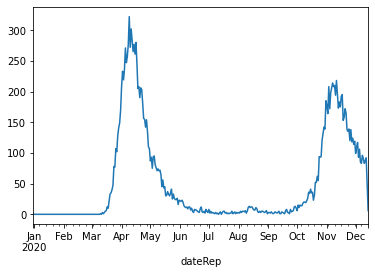

In [10]:
df_geo['deaths']['BE'].plot()

<AxesSubplot:xlabel='dateRep'>

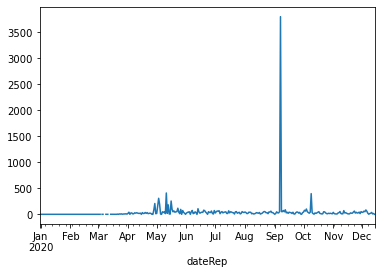

In [11]:
df_geo['deaths']['EC'].plot()

<AxesSubplot:xlabel='dateRep'>

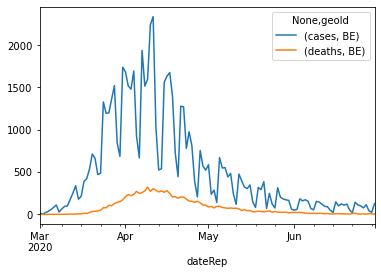

In [13]:
df_geo[[('cases', 'BE'), ('deaths', 'BE')]].loc["20200301":"20200630"].plot()

In [26]:
df = pd.read_csv("Openhealth_S-Grippal.csv", encoding="latin1", delimiter=";", decimal=",")
df

,PERIODE,IAS_brut,IAS_lissé,Incidence_Sentinelles
0,2009-07-01,1.7,2.2,2.3
1,2009-07-02,3.4,2.1,2.3
2,2009-07-03,2.1,2.1,2.3
3,2009-07-04,1.3,2.0,2.3
4,2009-07-05,14.2,2.0,2.3
...,...,...,...,...
4213,2021-01-12,19.0,16.8,NaN
4214,2021-01-13,12.5,16.5,NaN
4215,2021-01-14,29.6,16.3,NaN
4216,2021-01-15,12.4,16.2,NaN


In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4218 entries, 0 to 4217
Data columns (total 4 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   PERIODE                4218 non-null   object 
 1   IAS_brut               4218 non-null   float64
 2   IAS_lissé              4218 non-null   float64
 3   Incidence_Sentinelles  3449 non-null   float64
dtypes: float64(3), object(1)
memory usage: 131.9+ KB


In [28]:
df["PERIODE"] = pd.to_datetime(df["PERIODE"])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4218 entries, 0 to 4217
Data columns (total 4 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   PERIODE                4218 non-null   datetime64[ns]
 1   IAS_brut               4218 non-null   float64       
 2   IAS_lissé              4218 non-null   float64       
 3   Incidence_Sentinelles  3449 non-null   float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 131.9 KB


In [29]:
df = df.set_index("PERIODE")

In [30]:
df

,IAS_brut,IAS_lissé,Incidence_Sentinelles
PERIODE,,,
2009-07-01,1.7,2.2,2.3
2009-07-02,3.4,2.1,2.3
2009-07-03,2.1,2.1,2.3
2009-07-04,1.3,2.0,2.3
2009-07-05,14.2,2.0,2.3
...,...,...,...
2021-01-12,19.0,16.8,NaN
2021-01-13,12.5,16.5,NaN
2021-01-14,29.6,16.3,NaN


<AxesSubplot:xlabel='PERIODE'>

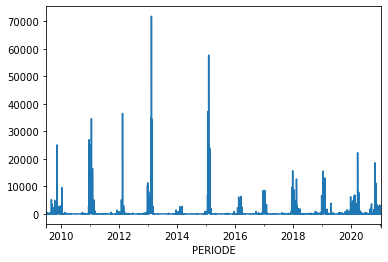

In [31]:
df["IAS_brut"].plot()

<AxesSubplot:xlabel='PERIODE'>

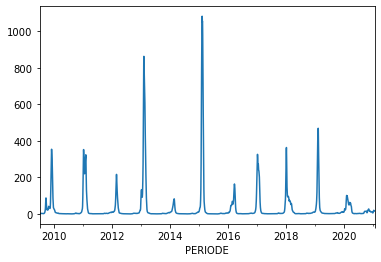

In [32]:
df["IAS_lissé"].plot()

In [ ]:
df_geo[df_geo['cases']['BE'] > 5000]['cases']['BE']

In [38]:
print(df[df["IAS_brut"] > 200]["IAS_brut"].loc["20180101":])

PERIODE
2018-01-01    15689.6
2018-01-02     1003.4
2018-01-03      466.2
2018-01-04      313.9
2018-01-07     7555.1
               ...   
2020-12-25     2790.7
2020-12-27      398.8
2021-01-01     3209.5
2021-01-03     3060.0
2021-01-10     1289.2
Name: IAS_brut, Length: 107, dtype: float64


<AxesSubplot:xlabel='PERIODE'>

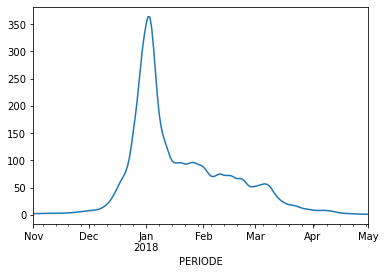

In [41]:
df["IAS_lissé"].loc["20171101":"20180501"].plot()

<AxesSubplot:xlabel='PERIODE'>

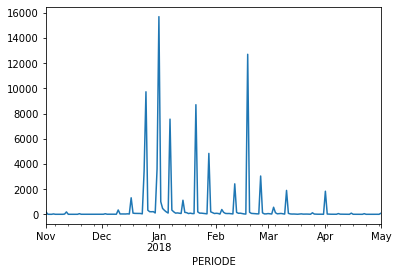

In [42]:
df["IAS_brut"].loc["20171101":"20180501"].plot()

In [44]:
df = pd.read_csv("Rpt_LabSurveillanceDataAnyWeekByCtry_Chart.csv")
df

,AH5_label,AH5_Chart01_CategoryGroup_label,AH5_Chart01_CategoryGroup_Chart01_CategoryGroup1_label,AH5_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,AH1_label,AH1_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,AH1N12009_label,AH1N12009_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,AH3_label,AH3_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,ANOTSUBTYPED_label,ANOTSUBTYPED_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,BYAMAGATA_label,BYAMAGATA_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,BVICTORIA_label,BVICTORIA_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0,BNOTDETERMINED_label,BNOTDETERMINED_Chart01_CategoryGroup_Chart01_CategoryGroup1_Value_DataValue0
0,AH5,2019,1,NaN,AH1,0.0,AH1N12009,1.0,AH3,7.0,ANOTSUBTYPED,0.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
1,AH5,2019,2,NaN,AH1,0.0,AH1N12009,4.0,AH3,13.0,ANOTSUBTYPED,4.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
2,AH5,2019,3,NaN,AH1,0.0,AH1N12009,1.0,AH3,12.0,ANOTSUBTYPED,4.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
3,AH5,2019,4,NaN,AH1,0.0,AH1N12009,8.0,AH3,10.0,ANOTSUBTYPED,3.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
4,AH5,2019,5,NaN,AH1,0.0,AH1N12009,6.0,AH3,21.0,ANOTSUBTYPED,4.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102,AH5,2020,51,NaN,AH1,0.0,AH1N12009,0.0,AH3,0.0,ANOTSUBTYPED,0.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
103,AH5,2020,52,NaN,AH1,0.0,AH1N12009,0.0,AH3,0.0,ANOTSUBTYPED,0.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0
104,AH5,2020,53,NaN,AH1,NaN,AH1N12009,NaN,AH3,NaN,ANOTSUBTYPED,NaN,BYAMAGATA,NaN,BVICTORIA,NaN,BNOTDETERMINED,NaN
105,AH5,2021,1,NaN,AH1,0.0,AH1N12009,0.0,AH3,0.0,ANOTSUBTYPED,0.0,BYAMAGATA,0.0,BVICTORIA,0.0,BNOTDETERMINED,0.0


In [48]:
df = pd.read_csv("incidence-PAY-3.csv", encoding="latin1")

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1889 entries, 0 to 1888
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   week        1889 non-null   int64  
 1   indicator   1889 non-null   int64  
 2   inc         1889 non-null   int64  
 3   inc_low     1888 non-null   float64
 4   inc_up      1888 non-null   float64
 5   inc100      1889 non-null   int64  
 6   inc100_low  1888 non-null   float64
 7   inc100_up   1888 non-null   float64
 8   geo_insee   1889 non-null   object 
 9   geo_name    1889 non-null   object 
dtypes: float64(4), int64(4), object(2)
memory usage: 147.7+ KB


In [50]:
df.head()

,week,indicator,inc,inc_low,inc_up,inc100,inc100_low,inc100_up,geo_insee,geo_name
0,202101,3,22841,18645.0,27037.0,35,29.0,41.0,FR,France
1,202053,3,21220,16498.0,25942.0,32,25.0,39.0,FR,France
2,202052,3,16428,12285.0,20571.0,25,19.0,31.0,FR,France
3,202051,3,21619,17370.0,25868.0,33,27.0,39.0,FR,France
4,202050,3,16845,13220.0,20470.0,26,20.0,32.0,FR,France


In [51]:
import seaborn as sns

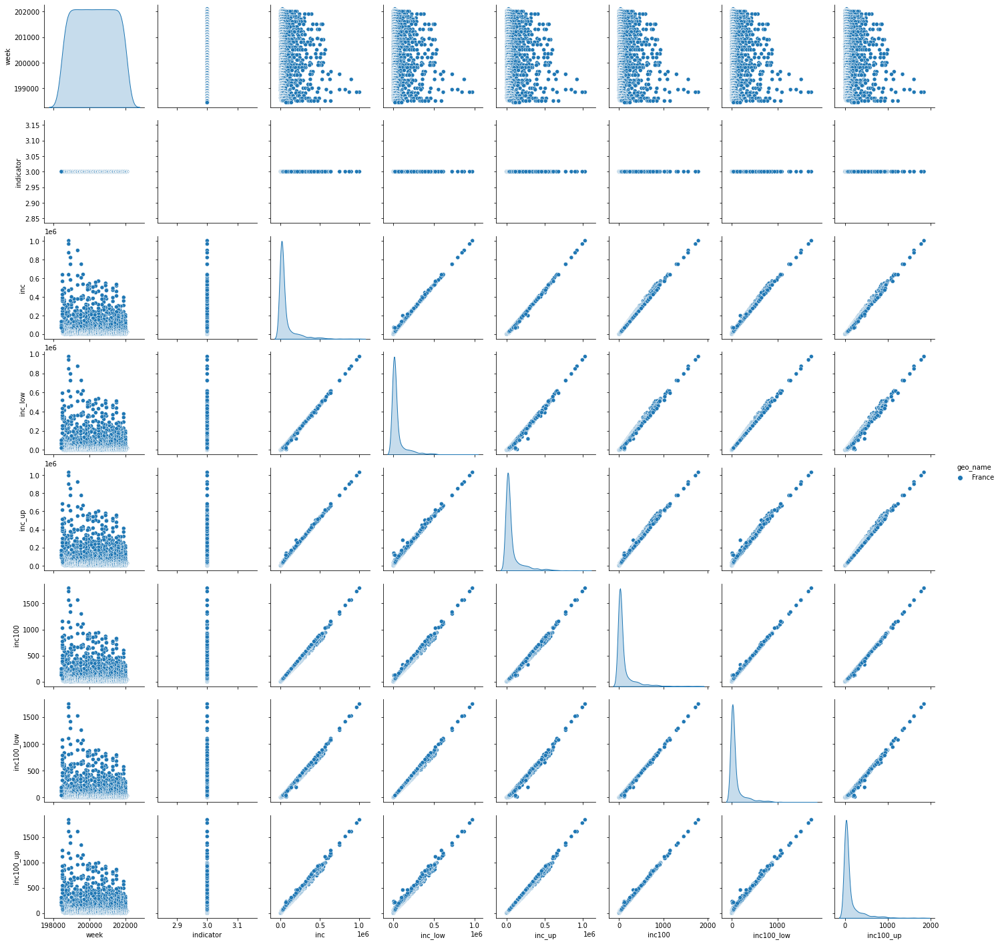

In [53]:
sns.pairplot(df, hue='geo_name')

In [55]:
df["indicator"].unique()

array([3])

<AxesSubplot:>

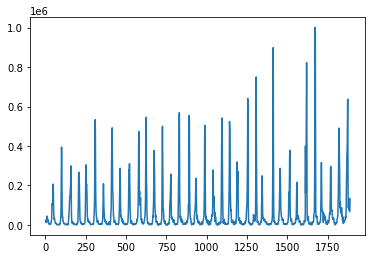

In [56]:
df